In [3]:
import pandas as pd
dftr=pd.read_csv('GUIDE_Train.CSV')

In [4]:
pd.set_option('display.max_columns', None)

In [5]:
dftr

,Id,OrgId,IncidentId,AlertId,Timestamp,DetectorId,AlertTitle,Category,MitreTechniques,IncidentGrade,ActionGrouped,ActionGranular,EntityType,EvidenceRole,DeviceId,Sha256,IpAddress,Url,AccountSid,AccountUpn,AccountObjectId,AccountName,DeviceName,NetworkMessageId,EmailClusterId,RegistryKey,RegistryValueName,RegistryValueData,ApplicationId,ApplicationName,OAuthApplicationId,ThreatFamily,FileName,FolderPath,ResourceIdName,ResourceType,Roles,OSFamily,OSVersion,AntispamDirection,SuspicionLevel,LastVerdict,CountryCode,State,City
0,180388628218,0,612,123247,2024-06-04T06:05:15.000Z,7,6,InitialAccess,NaN,TruePositive,NaN,NaN,Ip,Related,98799,138268,27,160396,441377,673934,425863,453297,153085,529644,NaN,1631,635,860,2251,3421,881,NaN,289573,117668,3586,NaN,NaN,5,66,NaN,NaN,NaN,31,6,3
1,455266534868,88,326,210035,2024-06-14T03:01:25.000Z,58,43,Exfiltration,NaN,FalsePositive,NaN,NaN,User,Impacted,98799,138268,360606,160396,22406,23032,22795,24887,153085,529644,NaN,1631,635,860,2251,3421,881,NaN,289573,117668,3586,NaN,NaN,5,66,NaN,NaN,NaN,242,1445,10630
2,1056561957389,809,58352,712507,2024-06-13T04:52:55.000Z,423,298,InitialAccess,T1189,FalsePositive,NaN,NaN,Url,Related,98799,138268,360606,68652,441377,673934,425863,453297,153085,529644,NaN,1631,635,860,2251,3421,881,NaN,289573,117668,3586,NaN,NaN,5,66,NaN,Suspicious,Suspicious,242,1445,10630
3,1279900258736,92,32992,774301,2024-06-10T16:39:36.000Z,2,2,CommandAndControl,NaN,BenignPositive,NaN,NaN,Url,Related,98799,138268,360606,13,441377,673934,425863,453297,153085,529644,NaN,1631,635,860,2251,3421,881,NaN,289573,117668,3586,NaN,NaN,5,66,NaN,Suspicious,Suspicious,242,1445,10630
4,214748368522,148,4359,188041,2024-06-15T01:08:07.000Z,9,74,Execution,NaN,TruePositive,NaN,NaN,User,Impacted,98799,138268,360606,160396,449,592,440,479,153085,529644,NaN,1631,635,860,2251,3421,881,NaN,289573,117668,3586,NaN,NaN,5,66,NaN,NaN,NaN,242,1445,10630
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9516832,1056561956622,0,90,496631,2024-06-08T15:26:08.000Z,7,6,InitialAccess,NaN,TruePositive,NaN,NaN,CloudLogonRequest,Related,98799,138268,360606,160396,441377,673934,425863,453297,153085,529644,NaN,1631,635,860,2251,3421,881,NaN,289573,117668,3586,NaN,NaN,5,66,NaN,NaN,NaN,242,1445,10630
9516833,1228360650033,59,196410,748366,2024-06-06T09:40:08.000Z,2,2,CommandAndControl,NaN,BenignPositive,NaN,NaN,Url,Related,98799,138268,360606,164,441377,673934,425863,453297,153085,529644,NaN,1631,635,860,2251,3421,881,NaN,289573,117668,3586,NaN,NaN,5,66,NaN,Suspicious,Suspicious,242,1445,10630
9516834,867583395122,44,14117,7425,2024-06-11T22:51:03.000Z,78,57,Exfiltration,NaN,BenignPositive,NaN,NaN,MailMessage,Impacted,98799,138268,360606,160396,441377,270,425863,453297,153085,22919,NaN,1631,635,860,2251,3421,881,NaN,289573,117668,3586,NaN,NaN,5,66,NaN,NaN,NaN,242,1445,10630
9516835,395136991850,43,644,8973,2024-05-20T23:01:01.000Z,52,10,Impact,NaN,BenignPositive,NaN,NaN,Ip,Related,98799,138268,465,160396,441377,673934,425863,453297,153085,529644,NaN,1631,635,860,2251,3421,881,NaN,289573,117668,3586,NaN,NaN,5,66,NaN,NaN,NaN,242,1445,10630


In [6]:
dftr.isna().sum()

Id                          0
OrgId                       0
IncidentId                  0
AlertId                     0
Timestamp                   0
DetectorId                  0
AlertTitle                  0
Category                    0
MitreTechniques       5468386
IncidentGrade           51340
ActionGrouped         9460773
ActionGranular        9460773
EntityType                  0
EvidenceRole                0
DeviceId                    0
Sha256                      0
IpAddress                   0
Url                         0
AccountSid                  0
AccountUpn                  0
AccountObjectId             0
AccountName                 0
DeviceName                  0
NetworkMessageId            0
EmailClusterId        9420025
RegistryKey                 0
RegistryValueName           0
RegistryValueData           0
ApplicationId               0
ApplicationName             0
OAuthApplicationId          0
ThreatFamily          9441956
FileName                    0
FolderPath

In [7]:
dftr.dropna(subset=["IncidentGrade"], inplace=True)

In [8]:
dftr.drop(columns=['MitreTechniques','ActionGrouped','ActionGranular','EmailClusterId','ThreatFamily','ResourceType','Roles','AntispamDirection','SuspicionLevel','LastVerdict'], inplace=True)

In [9]:
from sklearn.feature_selection import chi2
from sklearn.preprocessing import LabelEncoder

x =  dftr[['Category','EvidenceRole','EntityType']]

y= dftr['IncidentGrade']

for i in x.columns:
    x[i] = LabelEncoder().fit_transform(x[i])
y= LabelEncoder().fit_transform(y)

chi_scores = chi2(x,y)

p_values = pd.Series(chi_scores[0],index = x.columns)
p_values.sort_values(ascending = False , inplace = True)
print(p_values)



C:\Users\Katana\AppData\Local\Temp\ipykernel_23256\3160876067.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  x[i] = LabelEncoder().fit_transform(x[i])
C:\Users\Katana\AppData\Local\Temp\ipykernel_23256\3160876067.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  x[i] = LabelEncoder().fit_transform(x[i])
C:\Users\Katana\AppData\Local\Temp\ipykernel_23256\3160876067.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

EntityType      729084.973234
Category        525943.350276
EvidenceRole    110074.928007
dtype: float64


<Axes: >

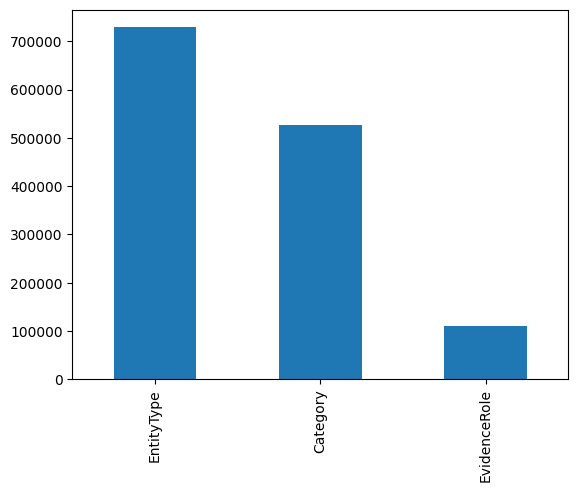

In [10]:

p_values.plot.bar()

In [11]:
anova= dftr[['Id','OrgId','IncidentId','AlertId','DetectorId','AlertTitle','DeviceId','Sha256','IpAddress','Url','AccountSid','AccountUpn','AccountObjectId','AccountName','DeviceName','NetworkMessageId','RegistryKey','RegistryValueName','RegistryValueData','ApplicationId','ApplicationName','OAuthApplicationId','FileName','FolderPath','ResourceIdName','OSFamily','OSVersion','CountryCode','State','City']]

In [12]:
from sklearn.feature_selection import SelectKBest, f_classif

selector = SelectKBest(score_func=f_classif, k=15)
X_train_selected = selector.fit_transform(anova, y)
 
selected_features = anova.columns[selector.get_support()]
print(f"Selected Features: {selected_features.tolist()}")
 

Selected Features: ['OrgId', 'IncidentId', 'AlertId', 'DetectorId', 'AlertTitle', 'Sha256', 'IpAddress', 'AccountObjectId', 'DeviceName', 'NetworkMessageId', 'FileName', 'FolderPath', 'CountryCode', 'State', 'City']


In [13]:
selected_features=selected_features.tolist()
selected_features.append('EntityType')
selected_features.append('Category')

In [14]:
dftr=dftr[selected_features]

In [15]:
dftr

,OrgId,IncidentId,AlertId,DetectorId,AlertTitle,Sha256,IpAddress,AccountObjectId,DeviceName,NetworkMessageId,FileName,FolderPath,CountryCode,State,City,EntityType,Category
0,0,612,123247,7,6,138268,27,425863,153085,529644,289573,117668,31,6,3,Ip,InitialAccess
1,88,326,210035,58,43,138268,360606,22795,153085,529644,289573,117668,242,1445,10630,User,Exfiltration
2,809,58352,712507,423,298,138268,360606,425863,153085,529644,289573,117668,242,1445,10630,Url,InitialAccess
3,92,32992,774301,2,2,138268,360606,425863,153085,529644,289573,117668,242,1445,10630,Url,CommandAndControl
4,148,4359,188041,9,74,138268,360606,440,153085,529644,289573,117668,242,1445,10630,User,Execution
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9516832,0,90,496631,7,6,138268,360606,425863,153085,529644,289573,117668,242,1445,10630,CloudLogonRequest,InitialAccess
9516833,59,196410,748366,2,2,138268,360606,425863,153085,529644,289573,117668,242,1445,10630,Url,CommandAndControl
9516834,44,14117,7425,78,57,138268,360606,425863,153085,22919,289573,117668,242,1445,10630,MailMessage,Exfiltration
9516835,43,644,8973,52,10,138268,465,425863,153085,529644,289573,117668,242,1445,10630,Ip,Impact


In [16]:
y

array([2, 1, 1, ..., 0, 0, 0])

In [17]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder

rf=RandomForestClassifier()

for i in ['EntityType','Category']:
    dftr[i] = LabelEncoder().fit_transform(dftr[i])





C:\Users\Katana\AppData\Local\Temp\ipykernel_23256\1396177150.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dftr[i] = LabelEncoder().fit_transform(dftr[i])
C:\Users\Katana\AppData\Local\Temp\ipykernel_23256\1396177150.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dftr[i] = LabelEncoder().fit_transform(dftr[i])


In [18]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(dftr, y, test_size=0.2, random_state=42)

In [19]:
y_pred=rf.fit(x_train,y_train)

In [20]:
y_predict2=rf.predict(x_test)

In [21]:
from sklearn.metrics import accuracy_score

score=accuracy_score(y_test,y_predict2)

score

0.987937245787333

In [22]:
from sklearn.metrics import classification_report, f1_score, precision_score, recall_score

macro_f1 = f1_score(y_test, y_predict2, average='macro')
precision = precision_score(y_test, y_predict2, average='macro')
recall = recall_score(y_test, y_predict2, average='macro')

print(f"Macro F1 Score: {macro_f1}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")

Macro F1 Score: 0.9867352311276226
Precision: 0.9868700052077637
Recall: 0.9866047351133175


Feature ranking:
1. Feature 0 (0.3114812564443988)
2. Feature 1 (0.18607002628890498)
3. Feature 3 (0.12641756361628304)
4. Feature 2 (0.12330514067651294)
5. Feature 4 (0.09354436746919963)
6. Feature 16 (0.04610338059553119)
7. Feature 7 (0.022870358026284635)
8. Feature 15 (0.016159165262014354)
9. Feature 6 (0.013742602539730779)
10. Feature 9 (0.012628986897950365)
11. Feature 12 (0.012261944698980645)
12. Feature 8 (0.009443390701862384)
13. Feature 10 (0.006199270968522224)
14. Feature 11 (0.00587734850226094)
15. Feature 5 (0.005337893948309949)
16. Feature 14 (0.0045732288559007205)
17. Feature 13 (0.003984074507352298)


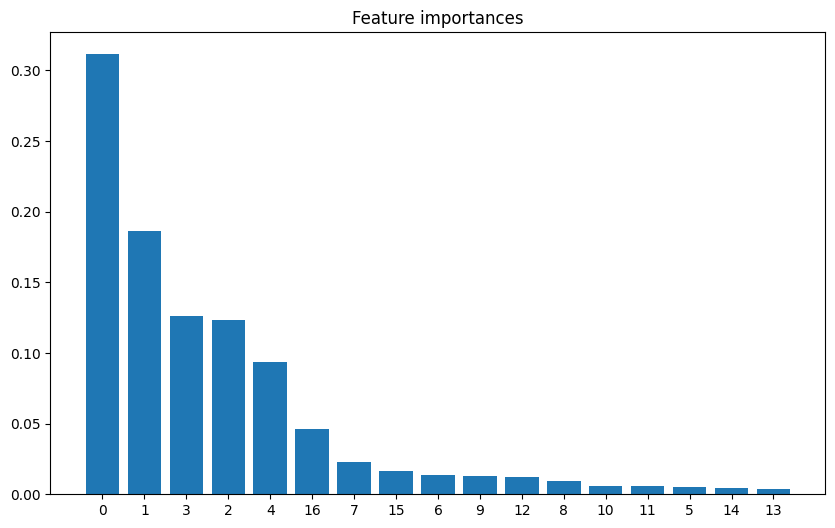

In [23]:
import matplotlib.pyplot as plt
# Feature Importance
import numpy as np
importances = rf.feature_importances_
indices = np.argsort(importances)[::-1]

# Print feature ranking
print("Feature ranking:")
for f in range(x_train.shape[1]):
    print(f"{f + 1}. Feature {indices[f]} ({importances[indices[f]]})")

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.title("Feature importances")
plt.bar(range(x_train.shape[1]), importances[indices], align="center")
plt.xticks(range(x_train.shape[1]), indices)
plt.show()


In [24]:
dftr

,OrgId,IncidentId,AlertId,DetectorId,AlertTitle,Sha256,IpAddress,AccountObjectId,DeviceName,NetworkMessageId,FileName,FolderPath,CountryCode,State,City,EntityType,Category
0,0,612,123247,7,6,138268,27,425863,153085,529644,289573,117668,31,6,3,15,10
1,88,326,210035,58,43,138268,360606,22795,153085,529644,289573,117668,242,1445,10630,32,7
2,809,58352,712507,423,298,138268,360606,425863,153085,529644,289573,117668,242,1445,10630,31,10
3,92,32992,774301,2,2,138268,360606,425863,153085,529644,289573,117668,242,1445,10630,31,1
4,148,4359,188041,9,74,138268,360606,440,153085,529644,289573,117668,242,1445,10630,32,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9516832,0,90,496631,7,6,138268,360606,425863,153085,529644,289573,117668,242,1445,10630,6,10
9516833,59,196410,748366,2,2,138268,360606,425863,153085,529644,289573,117668,242,1445,10630,31,1
9516834,44,14117,7425,78,57,138268,360606,425863,153085,22919,289573,117668,242,1445,10630,21,7
9516835,43,644,8973,52,10,138268,465,425863,153085,529644,289573,117668,242,1445,10630,15,9


In [25]:
for i in y_test:
    print(i)

0
0
2
0
0
2
0
0
1
0
2
2
0
1
1
1
2
0
0
1
2
1
2
2
1
0
0
0
1
0
1
1
0
2
0
1
0
0
0
0
0
0
0
1
2
1
1
1
0
2
2
0
1
1
1
2
2
2
1
1
0
1
2
0
2
0
0
2
0
2
0
2
0
0
1
2
2
2
0
0
2
1
2
0
2
2
0
2
2
1
1
0
2
0
0
0
1
1
1
2
0
2
2
1
0
0
1
0
1
0
2
1
2
1
0
0
0
0
2
1
0
2
2
2
0
2
0
0
2
0
0
1
2
1
0
0
1
1
2
2
0
1
1
0
2
1
2
2
2
2
0
0
2
2
1
0
1
2
0
1
1
1
2
0
0
0
0
0
2
0
2
1
2
0
1
1
0
2
0
1
1
1
2
2
1
1
0
0
2
2
0
0
0
2
0
1
0
1
0
1
2
0
0
0
2
0
2
2
0
0
2
0
0
0
2
2
0
2
2
2
0
0
0
0
1
2
0
2
2
2
0
0
2
2
0
1
0
0
0
2
0
0
2
0
0
2
1
0
1
0
2
2
2
2
2
2
1
1
1
2
1
0
2
2
0
0
2
1
0
2
2
0
2
2
1
0
0
0
1
1
0
0
0
0
0
0
1
0
2
0
2
2
1
1
1
0
2
0
2
1
1
0
0
2
0
0
0
2
0
0
0
2
2
2
0
0
1
1
0
1
1
2
0
1
1
0
1
2
0
2
1
1
0
1
2
1
0
2
1
0
1
1
1
2
1
1
0
0
0
0
0
2
0
2
0
0
0
0
0
2
2
0
2
1
2
2
2
2
1
2
2
0
2
2
2
1
0
0
0
1
0
2
0
0
1
0
1
0
2
0
1
2
2
1
2
2
2
0
0
0
2
0
0
2
0
1
2
1
2
2
1
1
0
0
0
0
0
0
0
2
0
2
2
2
0
1
0
0
2
0
0
1
1
2
1
2
1
0
0
2
0
2
0
0
2
0
2
2
1
0
1
2
0
0
0
2
0
2
0
1
2
2
2
1
0
2
1
2
0
1
0
2
0
0
0
2
1
1
0
1
0
2
2
1
0
1
0
1
1
0
2
2
0
0
2
2
0
2
0
0


In [26]:
y_train

array([2, 0, 1, ..., 0, 2, 1])

In [27]:
import pickle
with open('model.pkl', 'wb') as f:
    pickle.dump(rf, f)

In [28]:
dftr.corr()

,OrgId,IncidentId,AlertId,DetectorId,AlertTitle,Sha256,IpAddress,AccountObjectId,DeviceName,NetworkMessageId,FileName,FolderPath,CountryCode,State,City,EntityType,Category
OrgId,1.000000,0.018755,0.151226,0.150366,-0.005523,0.000187,0.115201,-0.019886,0.040939,0.016003,0.008771,0.024124,0.023956,0.023572,0.025874,0.022078,0.077279
IncidentId,0.018755,1.000000,0.409787,0.041120,0.103688,-0.027724,0.132250,-0.016116,0.010534,0.059135,-0.019165,-0.001157,0.046531,0.040973,0.042569,0.023886,0.045493
AlertId,0.151226,0.409787,1.000000,0.125186,0.146348,0.004614,0.082313,-0.085209,0.028351,0.187057,0.042750,0.048907,-0.160470,-0.155844,-0.154653,-0.044896,0.107035
DetectorId,0.150366,0.041120,0.125186,1.000000,0.239758,-0.024809,0.040076,0.023038,-0.035579,0.004887,-0.045177,-0.062405,0.069470,0.063532,0.063244,0.046536,-0.056778
AlertTitle,-0.005523,0.103688,0.146348,0.239758,1.000000,0.007376,0.082511,0.020326,-0.000773,-0.142126,-0.040503,-0.086796,0.074148,0.067676,0.067599,0.009123,-0.093767
Sha256,0.000187,-0.027724,0.004614,-0.024809,0.007376,1.000000,-0.149853,-0.147888,-0.077107,-0.098872,0.863976,0.751072,-0.082460,-0.075281,-0.075204,0.034795,0.044664
IpAddress,0.115201,0.132250,0.082313,0.040076,0.082511,-0.149853,1.000000,-0.279195,-0.145570,-0.186659,-0.178710,-0.166473,0.519723,0.483577,0.485168,0.322143,-0.078287
AccountObjectId,-0.019886,-0.016116,-0.085209,0.023038,0.020326,-0.147888,-0.279195,1.000000,-0.143661,-0.184211,-0.176366,-0.164290,-0.153633,-0.140258,-0.140114,-0.596610,-0.067511
DeviceName,0.040939,0.010534,0.028351,-0.035579,-0.000773,-0.077107,-0.145570,-0.143661,1.000000,-0.096046,-0.091956,-0.085659,-0.080103,-0.073129,-0.073054,0.038785,0.035360
NetworkMessageId,0.016003,0.059135,0.187057,0.004887,-0.142126,-0.098872,-0.186659,-0.184211,-0.096046,1.000000,-0.117911,-0.109838,-0.102713,-0.093771,-0.093675,-0.032404,0.060706


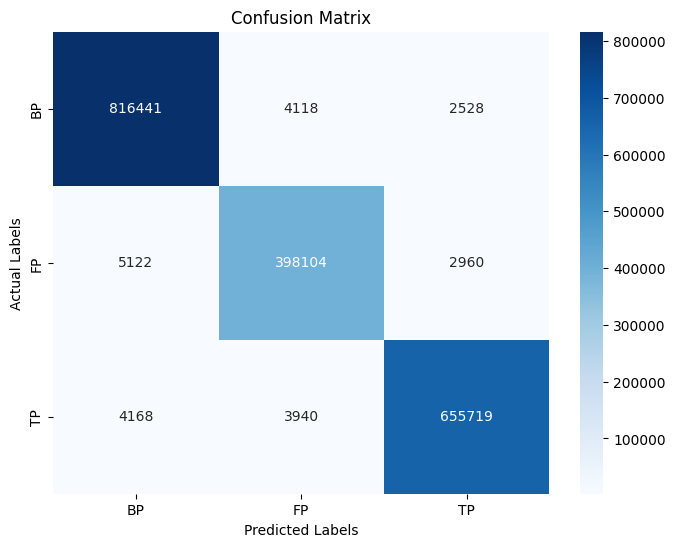

In [30]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming y_val are your actual labels and y_pred are your predicted labels
cm = confusion_matrix(y_test, y_predict2)

# Define the labels corresponding to 0, 1, 2
labels = ['BP', 'FP', 'TP']

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=labels, yticklabels=labels)
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()
